In [17]:


# Native libraries
import os
import math
# Essential Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
# Preprocessing
from sklearn.preprocessing import MinMaxScaler
# Algorithms
from minisom import MiniSom
import numpy.random as rd

##MARCHENT PAS CAR NUMPY 1.20.3 MAIS PAS GRAVE POUR SOM
# from tslearn.barycenters import dtw_barycenter_averaging
# from tslearn.clustering import TimeSeriesKMeans
# from sklearn.cluster import KMeans

from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix



In [3]:
#fonctions et variables utiles

def read_text_file(file_path):
    with open(file_path, encoding='ISO-8859-1') as f:
        lines = f.readlines()
        return lines
        
def read_number_line(some_line):
    return [float(s) for s in some_line.split()]

# my_dpi = np.sqrt(1920**2 + 1080**2)/17.3 #dpi de l'écran
# tnorm = 60. #normalisation du temps
# vnorm = 1.05 #normalisation de la vitesse

In [4]:
##création des dossiers pour récupérer les .png

#training
folder = "C:/Users/victo/stage_navier_jupyter/data_eurotunnel/Data/training/"
pk_folder = "1775_20190128/" #le PK qu'on va traiter
save_path = "C:/Users/victo/stage_navier_jupyter/data_eurotunnel/data_png/training_png/"

done = ["1775_20190128/", "1780_20190128/", "1785_20190128/", "1795_20190128/", "1800_20190128/", "1805_20190128/",
        "1810_20190128/", "1815_20190128/", "1820_20190128/", "1825_20190128/", "1830_20190128/", "1835_20190128/",
        "1840_20190128/", "3020_20190218/", "3025_20190218/", "3030_20190218/", "3035_20190218/", "3040_20190218/",
        "3045_20190218/", "3050_20190218/", "3055_20190218/", "3060_20190218/", "3065_20190218/", "3070_20190218/",
        "3075_20190218/", "3080_20190218/", "4230_20190225/", "4235_20190225/", "4240_20190225/", "4255_20190225/",
        "4260_20190225/"]
failed = ["1790_20190128/", "3015_20190218"]

# #validation
# folder = "C:/Users/victo/stage_navier_jupyter/data_eurotunnel/Data/validation/"
# pk_folder = "4250_20190225/" #le PK qu'on va traiter
# save_path = "C:/Users/victo/stage_navier_jupyter/data_eurotunnel/data_png/validation_png/"

done_val = ["4245_20190225/", "4250_20190225/"]

os.chdir(folder)

if not os.path.exists(save_path+pk_folder):
    os.makedirs(save_path+pk_folder) #crée le path pour ce PK 



In [5]:
# path = folder + pk_folder #pour accéder aux fichiers .blochet du PK pk_folder

mySeries = [] #series pandas
namesofMySeries = [] #nom correspondant a chaque blochet

# os.chdir(path) #current directory: C:/Users/victo/stage_navier_jupyter/data_eurotunnel/Data/training/1775-20190128/

def read_text_file(file_path):
    with open(file_path, encoding='ISO-8859-1') as f:
        lines = f.readlines()
        return lines
    
y_true = []

for pk_folder_loop in os.listdir(folder):
    if (pk_folder_loop + "/") in done:
        path = folder + pk_folder_loop
        for file in os.listdir(path):
            if file.endswith(".blochet"):
                file_path = f"{path}/{file}"
                lines = read_text_file(file_path)
                
                y_true.append(int(lines[-1][-1]))

                times = []
                speeds = []
                freqs = []
                frfs_real = []
                frfs_imag = []

                lines_to_read = lines[15:len(lines)-1] #valeurs commencent ligne 16 et saut de ligne à la fin
                
                for i in range(len(lines_to_read)):
                    read_line = read_number_line(lines_to_read[i])
                    times.append(read_line[0])
                    speeds.append(read_line[1])
                    freqs.append(read_line[2])
                    frfs_real.append(read_line[3])
                    frfs_imag.append(read_line[4])

                dict = {"Temps":times, "Vitesses":speeds, "Fréquences":freqs, "FRF réel":frfs_real, "FRF imag":frfs_imag}
                df = pd.DataFrame(dict)

                df = df.loc[:, ["Temps", "Vitesses"]]
                df.set_index("Temps", inplace=True)

                mySeries.append(df)
                namesofMySeries.append(pk_folder_loop + "_" + file[:-8])

In [6]:
len(mySeries)

4850

In [7]:
mySeries[42]

,Vitesses
Temps,
0.000000,0.001956
0.097656,0.002443
0.195312,0.001975
0.292969,0.003927
0.390625,0.002536
...,...
59.472660,-0.000771
59.570310,0.000244
59.667970,0.000449


In [16]:
y_true_values = {x for x in y_true}
print("Valeurs inscrites: " + str(y_true_values) + "\n" + 
      "Bonne longueur de liste: " + str(len(mySeries)==len(y_true)) + "\n" +
      "Pourcentage de blochets inexploitables: " + str(round(100*(1 - np.sum(y_true)/len(y_true)), 3)) + "%" + "\n" +
      "Valeurs en str ou float: " + str(type(mySeries[-1][-1])))

Valeurs inscrites: {0, 1}
Bonne longueur de liste: True
Pourcentage de blochets inexploitables: 18.186%
Valeurs en str ou float: <class 'numpy.float64'>


In [19]:
# fig, axs = plt.subplots(485,10,figsize=(50,500))
# fig.suptitle('Series')
# for i in range(485):
#     for j in range(10):
#         if i*10+j+1>len(mySeries): # pass the others that we can't fill
#             continue
#         axs[i, j].plot(mySeries[i*10+j].values)
#         axs[i, j].set_title(namesofMySeries[i*10+j])
# plt.show()

Check si toutes les séries ont bien la même longueur:

In [9]:
series_lengths = {len(series) for series in mySeries}
print(series_lengths)

{614}


C'est le cas, pas besoin de correction on passe direct à la normalisation.

In [10]:
for i in range(len(mySeries)):
    scaler = MinMaxScaler()
    mySeries[i] = MinMaxScaler().fit_transform(mySeries[i])
    mySeries[i]= mySeries[i].reshape(len(mySeries[i]))

In [11]:
print("max: "+str(max(mySeries[0]))+"\tmin: "+str(min(mySeries[0])))
print(mySeries[0][-5:])

max: 1.0	min: 0.0
[0.40812886 0.40739371 0.40760733 0.40815812 0.40736352]


On "cache" ensuite la valeur de l'exploitabilité de chaque blochet dans la dernière valeur de la dernière donnée de vitesse de chaque blochet, faute d'un meilleur moyen. (Cacher dans les décimales ne fonctionnait pas à cause des erreurs d'arrondi)

In [37]:
for i in range(len(mySeries)):
    mySeries[i][-1] = float(y_true[i])
    
array_test = rd.randint(0, len(mySeries), size=1000)
stock_intermed = []
for indx in array_test:
    x = mySeries[indx][-1] #la dernière valeur
    stock_intermed.append(x)
dict_test = {x for x in stock_intermed}
print(dict_test)

float(1)

{0.0, 1.0}


1.0

On a tout normalisé, on peut donc passer à la SOM en elle-même:

In [12]:
som_x = som_y = math.ceil(math.sqrt(math.sqrt(len(mySeries))))
# I didn't see its significance but to make the map square,
# I calculated square root of map size which is 
# the square root of the number of series
# for the row and column counts of som

som = MiniSom(som_x, som_y,len(mySeries[0]), sigma=0.3, learning_rate = 0.1)

som.random_weights_init(mySeries)
som.train(mySeries, 5000)
# print(som.quantization_error(mySeries)) #print(type(win_map[(4, 2)]))

In [43]:
xpl_clusters = []
nxpl_clusters = []

def plot_som_series_averaged_center(som_x, som_y, win_map):
    fig, axs = plt.subplots(som_x,som_y,figsize=(25,25))
    fig.suptitle('Clusters')
    for x in range(som_x):
        for y in range(som_y):
            cluster = (x,y)
            if cluster in win_map.keys():
                count_tot = 0
                count_nxpl = 0
                for series in win_map[cluster]:
                    axs[cluster].plot(series,c="gray",alpha=0.5) 
                    count_tot += 1
                    last_line = series[-1]
                    if str(last_line) == "0.0":
                        count_nxpl += 1
                if 2*count_nxpl < count_tot: #si plus de la moitié de non exploitables, le cluster est non expl.
                    xpl_clusters.append(cluster)
                else:
                    nxpl_clusters.append(cluster)
                axs[cluster].plot(np.average(np.vstack(win_map[cluster]),axis=0),c="red")
            cluster_number = x*som_y+y+1
            axs[cluster].set_title(f"Cluster {cluster_number}")

    plt.show()

[array([0.40123737, 0.40263414, 0.40246266, 0.40316549, 0.40538326,
       0.40512115, 0.4062176 , 0.40868239, 0.41145461, 0.41382432,
       0.41504517, 0.42000851, 0.41916974, 0.42423882, 0.42468486,
       0.42475328, 0.42862284, 0.42364972, 0.42481636, 0.42170916,
       0.42057895, 0.41864817, 0.41851045, 0.41671472, 0.41710301,
       0.41777474, 0.41461423, 0.41720341, 0.41578976, 0.41396649,
       0.41640196, 0.41522821, 0.41629   , 0.4181577 , 0.41713855,
       0.42152968, 0.42148614, 0.4232641 , 0.42305263, 0.42553874,
       0.4245969 , 0.42491055, 0.42324366, 0.42610207, 0.42304907,
       0.4242868 , 0.4226208 , 0.42577154, 0.42407622, 0.42700038,
       0.4219935 , 0.43031194, 0.42333162, 0.43211832, 0.41920795,
       0.43610961, 0.4153526 , 0.43862417, 0.41154524, 0.43563959,
       0.44052563, 0.94834605, 1.        , 0.79836351, 0.67375299,
       0.14130427, 0.30104108, 0.44228669, 0.49868365, 0.63196095,
       0.22726624, 0.09319278, 0.05502595, 0.15286846, 0.5738

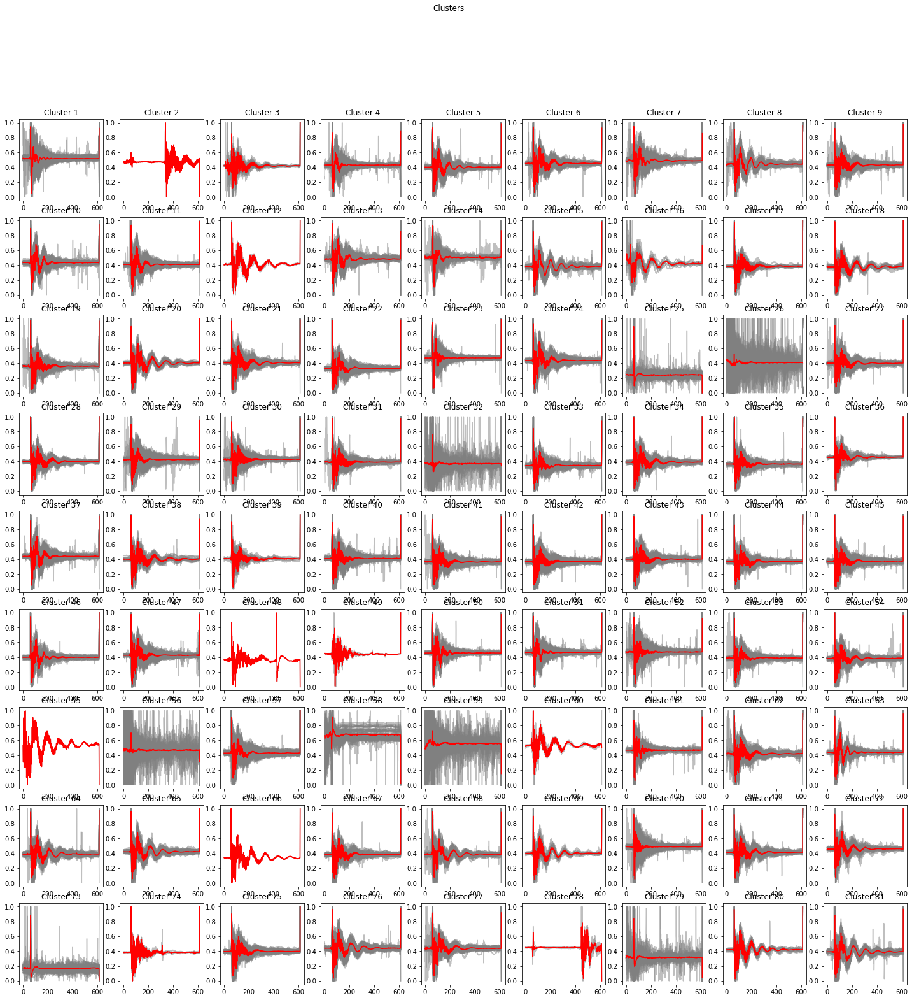

In [44]:
win_map = som.win_map(mySeries)
# print(list(win_map.keys()))
print(win_map.get((1, 2)))
print(type(win_map)) #<class 'collections.defaultdict'>
print(type(win_map[(4, 2)])) #<class 'list'>
print(type(win_map[(4, 2)][0])) #<class 'numpy.ndarray'>
# Returns the mapping of the winner nodes and inputs
plot_som_series_averaged_center(som_x, som_y, win_map)

On a 81 clusters pour les 4850 échantillons. Certains clusters rassemblent clairement des signaux tous bruités, les voici:

In [28]:
clusters_bruites = [9, 11, 14, 20, 35, 36, 37, 38, 47, 49, 52, 53, 54, 56, 57, 61, 74, 78, 80]
clusters_bruites.sort()

Cependant on voit que des clusters comme le 2 ou le 33 contiennent certains signaux bruités mélangés à une majorité de signaux traitables. Notre classification n'est donc pas parfaite, on va estimer grossièrement sa qualité.

On regarde maintenant l'effectif par cluster:

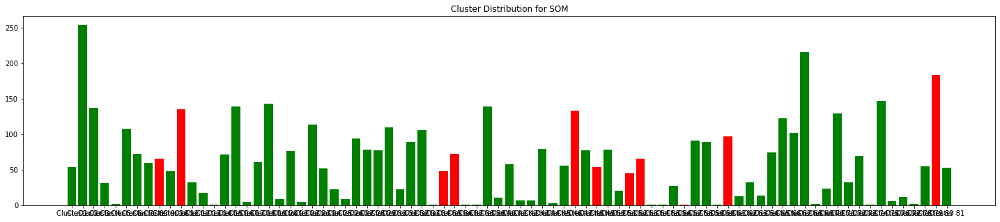

Signaux bruités : 900


In [30]:
cluster_c = []
cluster_n = []
colors = []
counter = 0
for x in range(som_x):
    for y in range(som_y):
        cluster = (x,y)
        if cluster in win_map.keys():
            cluster_c.append(len(win_map[cluster]))
        else:
            cluster_c.append(0)
        cluster_number = x*som_y+y+1
        cluster_n.append(f"Cluster {cluster_number}")
        if cluster_number in clusters_bruites: #clusters full bruités
            colors.append('r')
            counter += cluster_c[-1] #pour avoir le nombre d'elts bruités bien classés
        else:
            colors.append('g')

plt.figure(figsize=(25,5))
plt.title("Cluster Distribution for SOM")
plt.bar(cluster_n,cluster_c,color=colors)
plt.show()

print("Signaux bruités :", counter)

On a repéré 900 éléments bruités, soit 18.5% des signaux. 